In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
import seaborn as sns
import os
from scipy import signal
from scipy.signal import savgol_filter
from scipy.stats import gaussian_kde
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import grangercausalitytests
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.vector_ar.vecm import coint_johansen
from statsmodels.stats.outliers_influence import variance_inflation_factor
import warnings
from statsmodels.tools.sm_exceptions import ValueWarning

warnings.filterwarnings("ignore", message="covariance of constraints does not have full rank", category=ValueWarning)

In [2]:
# define functions


def remove_outliers_mad(data, threshold=3.5):
    median = np.median(data)
    absolute_deviation = np.abs(data - median)
    mad = np.median(absolute_deviation)
    normalized_absolute_deviation = absolute_deviation / mad
    outliers_mask = normalized_absolute_deviation > threshold
    
    # Remove outliers from the data
    filtered_data = data[~outliers_mask]
    return filtered_data





# More attributes at: https://www.statsmodels.org/stable/generated/statsmodels.tsa.vector_ar.vecm.JohansenTestResult.html#rdb8d6a7c069c-1
# Johansen’s test is a statistical procedure used to determine 
# if three or more time series are cointegrated. 
# It assesses the validity of a cointegrating relationship 
#  between time series variables. 
# If the test statistic is greater than the critical value, 
# it indicates a significant relationship.

def cointegration_test(df, alpha=0.05): 
    """Perform Johanson's Cointegration Test and Report Summary"""
    # print('Augmented Dickey-Fuller Test:')
    out = coint_johansen(df,-1,5)
    d = {'0.90':0, '0.95':1, '0.99':2}
    traces = out.lr1
    cvts = out.cvt[:, d[str(1-alpha)]]
    def adjust(val, length= 6): return str(val).ljust(length)

    # Summary
    print('Name   ::  Test Stat > C(95%)    =>   Signif  \n', '--'*20)
    for col, trace, cvt in zip(df.columns, traces, cvts):
        print(adjust(col), ':: ', adjust(round(trace,2), 9), ">", adjust(cvt, 8), ' =>  ' , trace > cvt)

# Granger’s Causality Test

#Test relationship between different features
#tests the null hypothesis that the coefficients 
# of past values in the regression equation is zero.
# i.e.  whether one time series variable can predict another. 
# A low p-value (less than 0.05) implies that the null hypothesis 
# can be rejected, meaning that there is 
# a Granger causal relationship between the variables.

def grangers_causation_matrix(data, variables, test='ssr_chi2test', verbose=False):    
    """
    data      : pandas dataframe containing the time series variables
    variables : list containing names of the time series variables.
    """
    
    maxlag=12
    test = 'ssr_chi2test'

    df = pd.DataFrame(np.zeros((len(variables), len(variables))), columns=variables, index=variables)
    for c in df.columns:
        for r in df.index:
            test_result = grangercausalitytests(data[[r, c]], maxlag=maxlag, verbose=False)
            p_values = [round(test_result[i+1][0][test][1],4) for i in range(maxlag)]
            if verbose: print(f'Y = {r}, X = {c}, P Values = {p_values}')
            min_p_value = np.min(p_values)
            df.loc[r, c] = min_p_value
    return df

def process_files(root_directory, device, seq_type):
    
    start_time = '2022-02-22 14:22:22'  # Choose a start time for your data
                

    data_frames = []


    device_directory = os.path.join(root_directory, device,'org')
    # print("Device directory:", device_directory)
    csv_files = [f for f in os.listdir(device_directory) if f.endswith('.csv')]
    for csv_file in csv_files:
        if seq_type in csv_file:
            file_path = os.path.join(device_directory, csv_file)
            data = pd.read_csv(file_path)
            

            # Remove unnecessary brackets
            # data = data.replace(to_replace='\[\[|\]\]', value='', regex=True)
            
            # remove_outliers(data, csv_file, directory)

            data_frames.append(data)

    return pd.concat(data_frames) 


def get_resource_name(resource):
    resources_dict = {'cpu_freq':'CPU Frequency', 'cpu':'Percent CPU Usage','cpu_user_time':'CPU User Time', 'cpu_idle_time':'CPU Idle Time', 'cpu_system_time':'CPU System Time', 'memory':'Percent Memory Usage', 'net_sent':'Network Bytes Sent', 'net_recv':'Network Bytes Recieved', 'net_upload_rate':'Network Upload Rate', 'net_download_rate':'Network Download Rate', 'temp':'Temperature','bit_rate':'Bit Rate','link_quality': 'Link Quality', 'signal_level': 'Signal Level', 'state':'Resource Usage State'}
    return resources_dict.get(resource)

def get_filter_name(filter_name):
    filter_dict = {'':'No Filter', '_sg_5_2' : 'Sav. Golay', '_sma_2': 'SMA', '_ema_1':'EMA' }
    return filter_dict.get(filter_name)

def analyze_data(df,device,sequence):
    # Calculate volatility, skewness, kurtosis, seasonal decomposition, 
    # and Granger's causality
    
    # Calculate volatility
    # These metrics measure the degree of variation in the data over time. 
    # High volatility indicates significant fluctuations, 
    # while low volatility suggests more stable data.
    rolling_volatility = df.rolling(window=10).std()
    
    ewma_volatility = df.ewm(span=10).std()
    
    # Calculate Skewness: measures the asymmetry of the probability distribution, 
    skewness = df.skew()
    # while kurtosis measures the "tailedness" of the distribution. 
    kurtosis = df.kurt()

    # Save the heatmap data to a CSV file
    sk_kur_data = pd.concat([skewness, kurtosis], axis=1, keys=['Skewness', 'Kurtosis'])
    sk_kur_data.to_csv(f'figures/data/{device}/{sequence}/skewness_kurtosis.csv')

    # These can provide insights into the underlying
    #  characteristics of the data distribution.
    

    # Decomposition into trend, seasonal and residual components
    decompositions = {}
    for column in df.columns:
        decompositions[column] = seasonal_decompose(df[column], period=int(5))


    
    # Granger's causality matrix
    grangers_matrix = grangers_causation_matrix(df, variables=df.columns)
    

    # Cointegration test
    cointegration_test(df)

    # Multicollinearity when two or more predictor variables are highly correlated. This can lead to unstable estimates and might cause the covariance matrix to lose rank
    # done due to the warning: covariance of constraints does not have full rank
    vif = pd.DataFrame()
    vif['Features'] = df.columns
    vif['VIF'] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
    print(vif)

    # Calculate correlations
    correlation = df.corr()
    print("Correlation: ")
    print(correlation)
    plot_heatmap(correlation, device, sequence, "Correlation")


    return decompositions, skewness, kurtosis, grangers_matrix, rolling_volatility, ewma_volatility


def plot_results(df, decomposition, key, dev, sequence):
    
    # Define the directory path
    directory = f'figures/data/{dev}/{sequence}/{key}/'

    # Create the directory if it doesn't exist
    os.makedirs(directory, exist_ok=True)


    # Set the seaborn style
    sns.set_style('whitegrid')
    
    # Define the pastel color palette

    # Periodogram
    plot_periodogram(df, key, sns.color_palette("pastel")[3], dev, sequence)

    # Autocorrelation
    corr = np.correlate(df[key], df[key], mode='full')
    print("Autocorrelation: ", pd.Series(corr).describe())
    fig, ax = plt.subplots(figsize=(10, 6))
    ax.plot(corr, color=sns.color_palette("pastel")[3])
    ax.set_xlabel('Lag', fontsize=14)
    ax.set_ylabel('Autocorrelation', fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.grid(True, which='both')
    fig.tight_layout()
    plt.savefig(os.path.join(directory, f'{key} Autocorrelation.png'))
    # plt.show()

    # Save the Autocorrelation data to a CSV file
    autocorr_data = pd.DataFrame({'Autocorrelation': corr})
    autocorr_data.to_csv(os.path.join(directory, 'autocorr_data.csv'), index=False)


    # Histogram
    fig, ax = plt.subplots(figsize=(10, 6))
    sns.histplot(df[key], kde=True, ax=ax, color=sns.color_palette("pastel")[3], label = "Kernel Density Estimate")
    ax.set_xlabel(key, fontsize=14)
    ax.set_ylabel('Count', fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.grid(True, which='both')
    fig.tight_layout()
    plt.legend()
    plt.savefig(os.path.join(directory, f'{key} Histogram.png'))
    # plt.show()

    # Calculate histogram data
    hist_data, bin_edges = np.histogram(df[key], bins='auto')

    # Calculate KDE
    kde = gaussian_kde(df[key])
    kde_values = kde(bin_edges)


    # Save the histogram data to a CSV file
    histogram_data = pd.DataFrame({'bin_edges': bin_edges[:-1],'hist_data': hist_data,'kde_values': kde_values[:-1]})
    histogram_data.to_csv(os.path.join(directory, 'histogram_data.csv'), index=False)


    # # Seasonal decomposition plots
    fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(10, 12))
    
    axes[0].set_title(key + ' - Trend', fontsize=16)
    axes[0].plot(decomposition[key].trend, color=sns.color_palette("pastel")[0])
    axes[1].set_title(key + ' - Residual', fontsize=16)
    axes[1].plot(decomposition[key].resid, color=sns.color_palette("pastel")[3])
    # axes[2].set_title(key + ' - Observed', fontsize=16)
    # axes[2].plot(decomposition[key].observed, color=sns.color_palette("pastel")[0])
    # axes[3].set_title(key + ' - Seasonal', fontsize=16)
    # axes[3].plot(decomposition[key].seasonal, color=sns.color_palette("pastel")[2])
  
    # Save the decomposition data to a CSV file
    decomposition_data = pd.DataFrame({'Trend': decomposition[key].trend, 'Residual': decomposition[key].resid, 'Seasonal':decomposition[key].seasonal})
    decomposition_data.to_csv(os.path.join(directory, 'decomposition_data.csv'), index=False)

    # Print statistical summary for trend
    trend_series = decomposition[key].trend.dropna()  # Remove NA values if any
    print("Trend statistical summary:")
    print(trend_series.describe())

    # Print statistical summary for seasonal
    seasonal_series = decomposition[key].seasonal.dropna()  # Remove NA values if any
    print("Seasonal statistical summary:")
    print(seasonal_series.describe())

    # Print statistical summary for residual
    resid_series = decomposition[key].resid.dropna()  # Remove NA values if any
    print("Residual statistical summary:")
    print(resid_series.describe())

    
    for ax in axes:
        ax.tick_params(axis='both', which='major', labelsize=12)

    fig.tight_layout()
    # Save the figure
    plt.savefig(os.path.join(directory, f'{key} Seasonal Decomposition.png'))
    # plt.show()

    # ACF and PACF
    acf_values = acf(df[key], nlags=200)
    pacf_values = pacf(df[key], nlags=200, method='ywm')
    print("ACF Values: ", acf_values)
    print("PACF Values: ", pacf_values)

    fig, ax1 = plt.subplots(figsize=(10, 6))
    plot_acf(df[key], ax=ax1, color=sns.color_palette("pastel")[0])
    # ax1.set_title('Autocorrelation', fontsize=18)
    ax1.set_xlabel('Lag', fontsize=14)
    ax1.set_ylabel('ACF', fontsize=14)
    ax1.tick_params(axis='both', which='major', labelsize=12)

    # Save the figure
    plt.savefig(os.path.join(directory, f'{key} ACF.png'))

    # plt.show()

    fig, ax2 = plt.subplots(figsize=(10, 6))
    plot_pacf(df[key], method='ywm', ax=ax2, color=sns.color_palette("pastel")[1])
    # ax2.set_title('Partial Autocorrelation', fontsize=18)
    ax2.set_xlabel('Lag', fontsize=14)
    ax2.set_ylabel('PACF', fontsize=14)
    ax2.tick_params(axis='both', which='major', labelsize=12)

    fig.tight_layout()
    
    # Save the figure
    plt.savefig(os.path.join(directory, f'{key} PACF.png'))

    # plt.show()

    # Save the decomposition data to a CSV file
    acf_data = pd.DataFrame({'ACF': acf_values, 'PACF': pacf_values})
    acf_data.to_csv(os.path.join(directory, 'acf_pacf_data.csv'), index=False)




    
def feature_analysis(data,device,sequence):

    # 1. Device Performance Analysis
    # Compare resource usage across different devices (assumption: 'cpu_freq' represents different devices)
    sns.set_theme(style="whitegrid")
    
    # device_performance = data.groupby('CPU Frequency').mean()[['Percent CPU Usage', 'Percent Memory Usage']]

    # # Convert the index to integer
    # device_performance.index = device_performance.index.astype(int)

    # # Plot Percent CPU Usage
    # plt.figure(figsize=(8, 4), dpi=300)
    # ax1 = device_performance['Percent CPU Usage'].plot(kind='bar', color=sns.color_palette("pastel")[0])
    # ax1.tick_params(labelsize=8, rotation=0)
    # ax1.set_xlabel('CPU Frequency', fontsize=10)
    # ax1.set_ylabel('Percent CPU Usage', fontsize=10)
    # # ax1.get_legend().remove()
    # plt.tight_layout()
    # # plt.savefig(f'figures/data/{device}/{sequence}/CPU Freq Bars/Percent_CPU_Usage_Bar_Plot.png')
    # plt.show()

    # # Plot Percent Memory Usage
    # plt.figure(figsize=(8, 4), dpi=300)
    # ax2 = device_performance['Percent Memory Usage'].plot(kind='bar', color=sns.color_palette("pastel")[1])
    # ax2.tick_params(labelsize=8, rotation=0)
    # ax2.set_xlabel('CPU Frequency', fontsize=10)
    # ax2.set_ylabel('Percent Memory Usage', fontsize=10)
    # # ax2.get_legend().remove()
    # plt.tight_layout()
    # # plt.savefig(f'figures/data/{device}/{sequence}/Percent_Memory_Usage_Bar_Plot.png')
    # plt.show()


    
    # Create a custom color palette
    resource_states = df['Resource Usage State'].unique()
    palette = sns.color_palette("pastel", len(resource_states))
    # color_dict = dict(zip(resource_states, palette))


    melted_df = pd.melt(df, id_vars='Resource Usage State', value_vars=['CPU User Time', 'CPU System Time','CPU Idle Time','Percent CPU Usage', 'Percent Memory Usage','Network Bytes Sent', 'Network Bytes Recieved', 'Network Upload Rate', 'Network Download Rate', 'Bit Rate','Temperature'])
    
    # Apply the outlier removal function to each group of your data
    # melted_df['value'] = remove_outliers_mad(melted_df['value'])

    for type in ['Bar', 'Box', 'Violin']:
        for variable in ['Network Bytes Sent', 'Network Bytes Recieved']: #'CPU User Time', 'CPU System Time','CPU Idle Time','Percent CPU Usage', 'Percent Memory Usage', 'Network Upload Rate', 'Network Download Rate', 'Bit Rate','Temperature'
            plt.figure(figsize=(4,4), dpi=300)
            subset = melted_df[melted_df.variable == variable]

            if type == 'Bar':
                # Bar plot
                ax = sns.barplot(x='Resource Usage State',y='value', data=subset, palette=dict(zip(resource_states, palette)), width=0.5)
            elif type == 'Box':
                # Box plot
                ax = sns.boxplot(x='Resource Usage State',y='value', data=subset, palette=dict(zip(resource_states, palette)), width=0.5, showfliers=True)
            elif type == 'Violin':
                # Violin plot
                ax = sns.violinplot(x='Resource Usage State',y='value', data=subset, palette=dict(zip(resource_states, palette)), inner='quartile', showfliers=True)
            

            # Set the number of y-ticks
            ax.yaxis.set_major_locator(MaxNLocator(nbins=1.5 * len(ax.get_yticks())))
            # plt.xlabel('Resource Usage State', fontsize=10)
            plt.ylabel(variable, fontsize=10)
            plt.xticks(rotation=0)
            plt.tight_layout()
            plt.savefig(f'figures/data/{device}/{sequence}/{type}/{variable} {type} Plot.png')
            # plt.show()



def plot_heatmap(data, dev, seq, var, annot=True, cmap='Pastel1', title=None, xlabel=None, ylabel=None): #'Pastel1', 'Pastel2', 'Wistia', 'spring'
    """
    Plots a heatmap for the given data.

    Parameters:
    data (DataFrame): A pandas DataFrame containing the data for the heatmap.
    annot (bool): If True, write the data value in each cell. Default is True.
    cmap (str): The color map to use for the heatmap. Default is 'seismic_r'.
    title (str): Title of the heatmap. Default is None.
    xlabel (str): Label for the x-axis. Default is None.
    ylabel (str): Label for the y-axis. Default is None.
    """
    plt.figure(figsize=(10, 8))
    sns.heatmap(data, annot=annot, cmap=cmap)
    
    if title:
        plt.title(title)
    if xlabel:
        plt.xlabel(xlabel)
    if ylabel:
        plt.ylabel(ylabel)
    
    plt.tight_layout()
    plt.savefig(f'figures/data/{dev}/{seq}/Heatmap/{var} Heatmap.png')
    
    # plt.show()

    # Save the heatmap data to a CSV file
    data.to_csv(f'figures/data/{dev}/{seq}/Heatmap/{var}.csv', index=False)

def prepare_heatmap_data(df, resource):
    heatmap_data = pd.DataFrame()
    for column in df.columns:
        if resource in column:
            heatmap_data[column] = df[column]
    return heatmap_data



def plot_periodogram(df, resource, color, device, sequence):
    
    # Define the directory path
    directory = f'figures/data/{device}/{sequence}/{resource}/'

    # Perform the periodogram
    f, Pxx_den = signal.periodogram(df[resource])

    # Save the periodogram data to a CSV file
    periodogram_data = pd.DataFrame({'Frequency': f, 'Pxx_den': Pxx_den})
    periodogram_data.to_csv(os.path.join(directory, 'periodogram_data.csv'), index=False)

    
    # Create the plot
    fig, ax = plt.subplots(figsize=(10, 6))  # Adjust the figure size as needed
    Pxx_den_series = pd.Series(Pxx_den)

    # Print statistical summary
    print('Periodogram Statistical Summary:')
    print(Pxx_den_series.describe())
    ax.semilogy(f[1:], Pxx_den[1:].T, color=color)  # Change the color to dark purple
    ax.semilogy(f[1:], pd.DataFrame(Pxx_den[1:].T).rolling(200, min_periods=1).mean(), color='red', label = 'Rolling Mean')
    # ax.set_ylim(bottom=1e-6)  # Only show values above 10^-8
    
    # Set the title and labels
    # ax.set_title(f'Power Spectral Density ({resource})', fontsize=18)
    ax.set_xlabel('Frequency [Hz]', fontsize=14)
    ax.set_ylabel('Power Spectral Density [V^2/Hz]', fontsize=14)
    
    # Customize tick label font sizes
    ax.tick_params(axis='both', which='major', labelsize=12)
    
    # Add gridlines
    ax.grid(True, which='both')
    plt.legend(loc='upper right')
    plt.tight_layout()

    
    # Create the directory if it doesn't exist
    os.makedirs(directory, exist_ok=True)

    # Save the figure
    plt.savefig(os.path.join(directory, f'{resource} Periodogram.png'))

def diff_data(df, columns, order=0.5):
        
    for col in columns:
        name1 = col + ' 1st Diff'
        # name2 = col + f'_{order}order_diff'
        # df[name2] = df[col]
        df[name1] = df[col].diff()
        # for i in range(1, df.shape[0]):
        #     df.loc[i, name2] = df.loc[i-1, name2] + order*(df.loc[i, col]-df.loc[i-1, col]-df.loc[i-1, name2])
    return df

def filter_data(df, columns, savgol_window_size = 5, savgol_degree = 2, sma_window_size = 2, ema_window_size = 1):
    
    for resource in columns:
        ts = df[resource].reset_index(drop=True)
        
        #Savistky-Golay Filter
        ts_sg = pd.DataFrame(savgol_filter(ts, savgol_window_size, savgol_degree))
        ts_sg[ts_sg < 0] = 0 
        df[resource+f'_sg_{savgol_window_size}_{savgol_degree}'] = ts_sg

        #Simple Moving Average Filter
        ts_sma = ts.rolling(sma_window_size, min_periods=1).mean()
        df[resource+f'_sma_{sma_window_size}'] = ts_sma

        #Exponential Moving Average Filter
        ts_ema = ts.ewm(ema_window_size).mean()
        df[resource+f'_ema_{ema_window_size}'] = ts_ema
    
    return df

Device: RPi4B8GB
Sequence Type: random
Name   ::  Test Stat > C(95%)    =>   Signif  
 ----------------------------------------
CPU Frequency ::  50132.23  > 311.1288  =>   True
Percent CPU Usage ::  32312.23  > 263.2603  =>   True
CPU User Time ::  23452.58  > 219.4051  =>   True
CPU System Time ::  14972.81  > 179.5199  =>   True
CPU Idle Time ::  7463.77   > 143.6691  =>   True
Percent Memory Usage ::  3350.1    > 111.7797  =>   True
Network Bytes Sent ::  389.29    > 83.9383   =>   True
Network Bytes Recieved ::  114.29    > 60.0627   =>   True
Network Upload Rate ::  46.84     > 40.1749   =>   True
Network Download Rate ::  15.61     > 24.2761   =>   False
Temperature ::  2.13      > 12.3212   =>   False
Bit Rate ::  0.62      > 4.1296    =>   False
                  Features           VIF
0            CPU Frequency      1.567412
1        Percent CPU Usage     14.666322
2            CPU User Time    470.008626
3          CPU System Time   4350.059103
4            CPU Idle Time    

<ipython-input-2-cf4aa7e80151>:428: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 6))  # Adjust the figure size as needed


Autocorrelation:  count    1.382230e+05
mean     1.194183e+14
std      8.105151e+13
min      2.510727e+09
25%      4.790920e+13
50%      1.041233e+14
75%      1.899240e+14
max      2.736843e+14
dtype: float64
Trend statistical summary:
count    69108.000000
mean     58785.721394
std      22454.776236
min      27514.900000
25%      37102.690500
50%      63976.518000
75%      79845.992000
max      91257.138000
Name: trend, dtype: float64
Seasonal statistical summary:
count    69112.000000
mean         0.000016
std          0.517161
min         -0.730098
25%         -0.367127
50%         -0.000362
75%          0.365665
max          0.731922
Name: seasonal, dtype: float64
Residual statistical summary:
count    69108.000000
mean         0.000025
std         60.755948
min     -10101.455902
25%         -0.383665
50%          0.000362
75%          0.385127
max      10100.404078
Name: resid, dtype: float64
ACF Values:  [1.         0.99996169 0.99992337 0.99988506 0.99984675 0.99980843
 0.999770

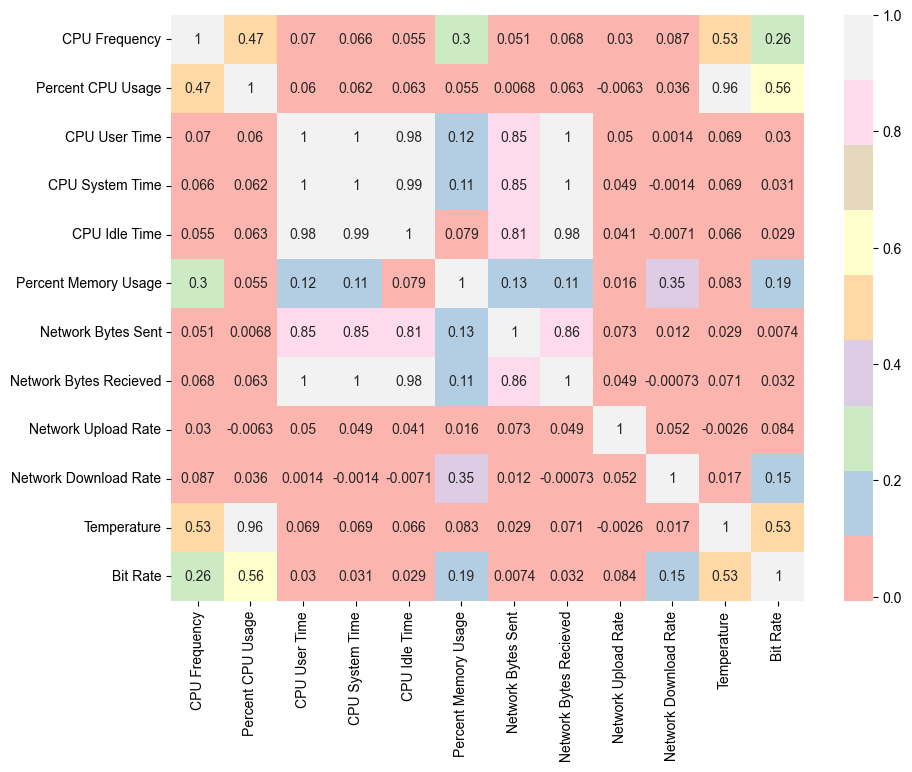

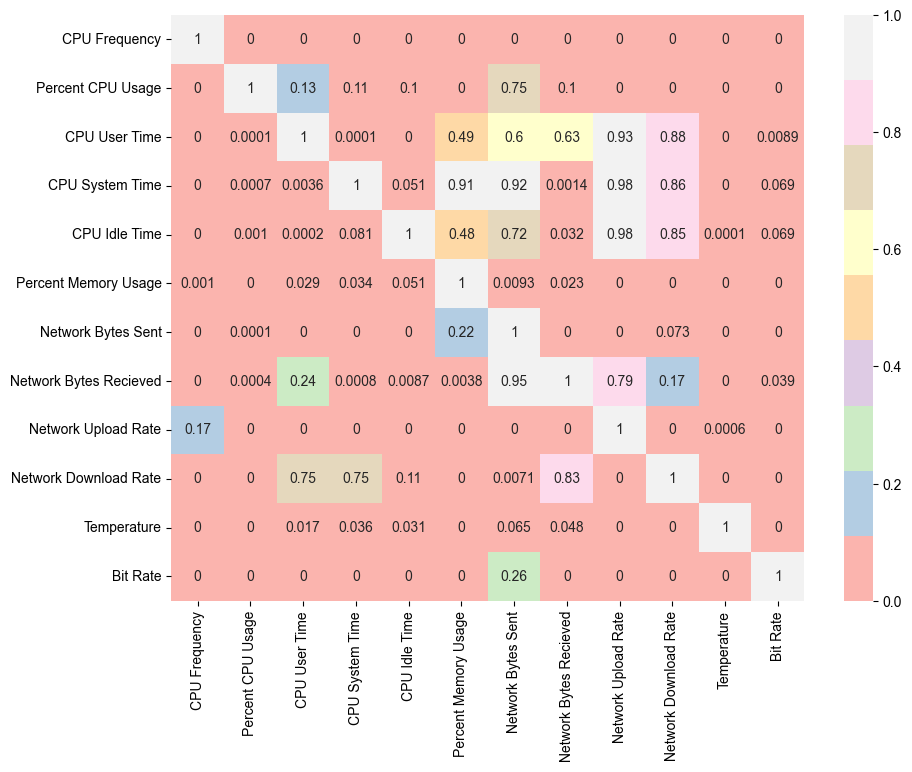

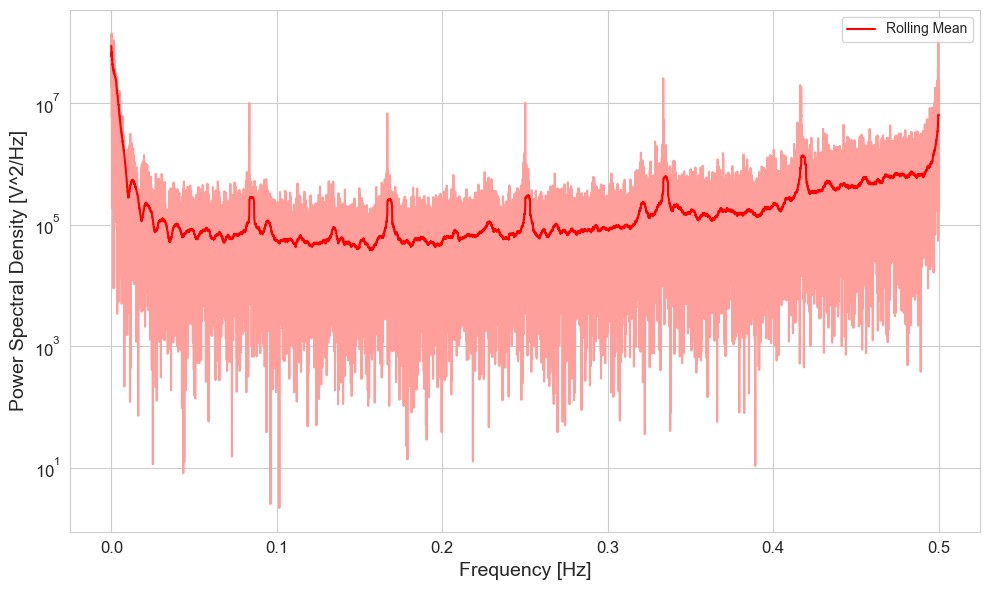

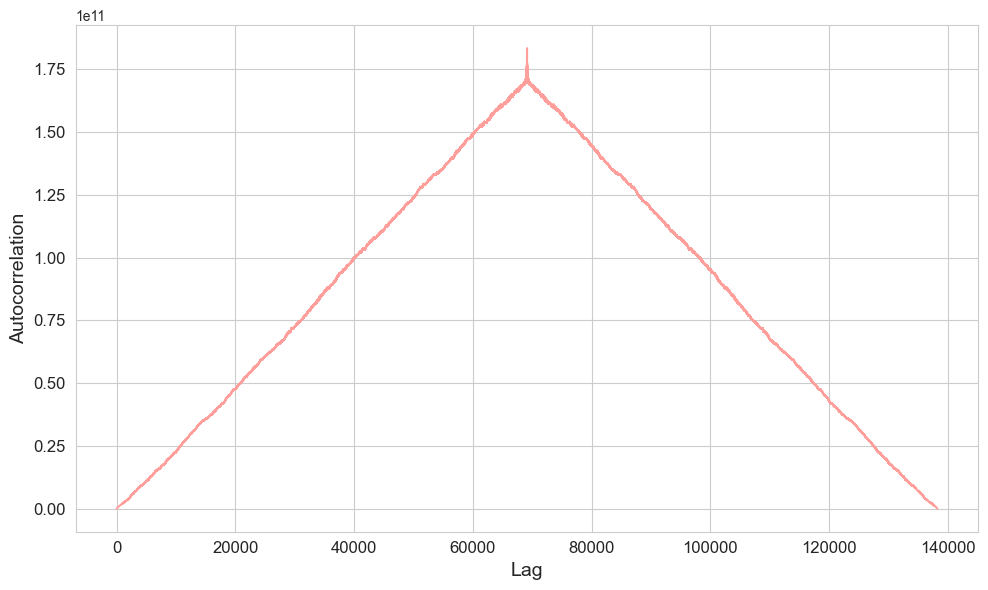

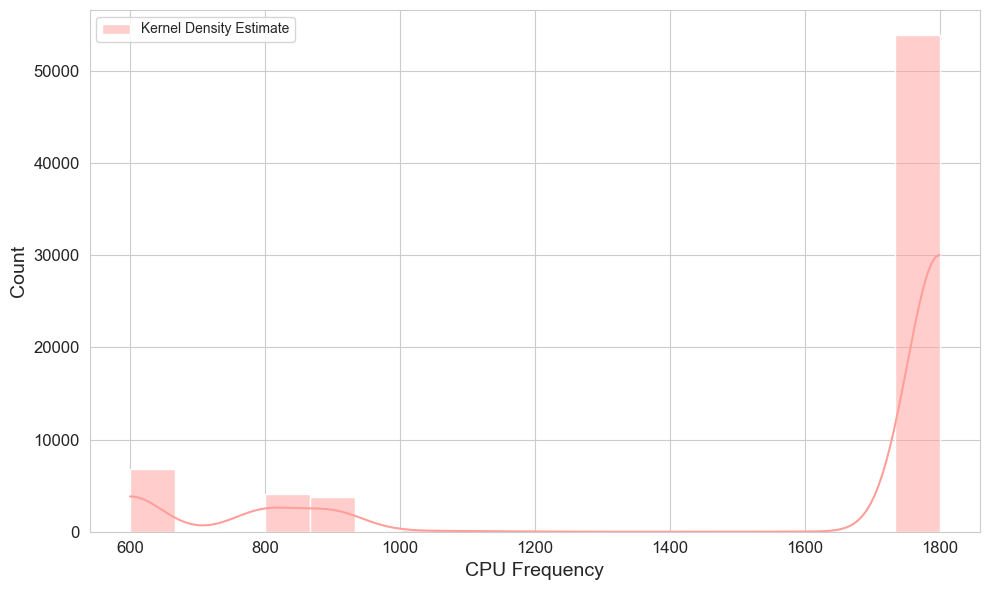

...

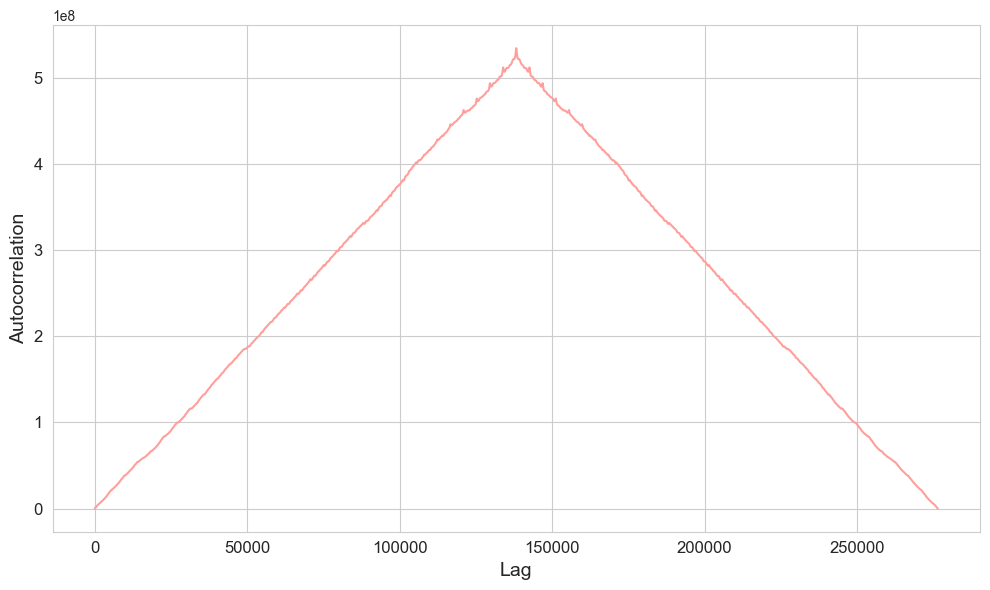

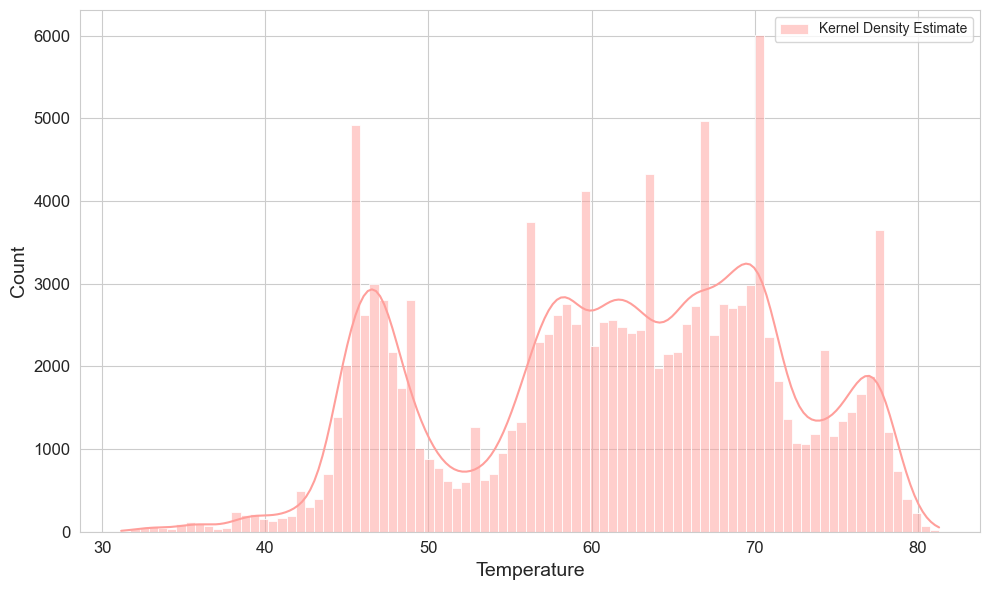

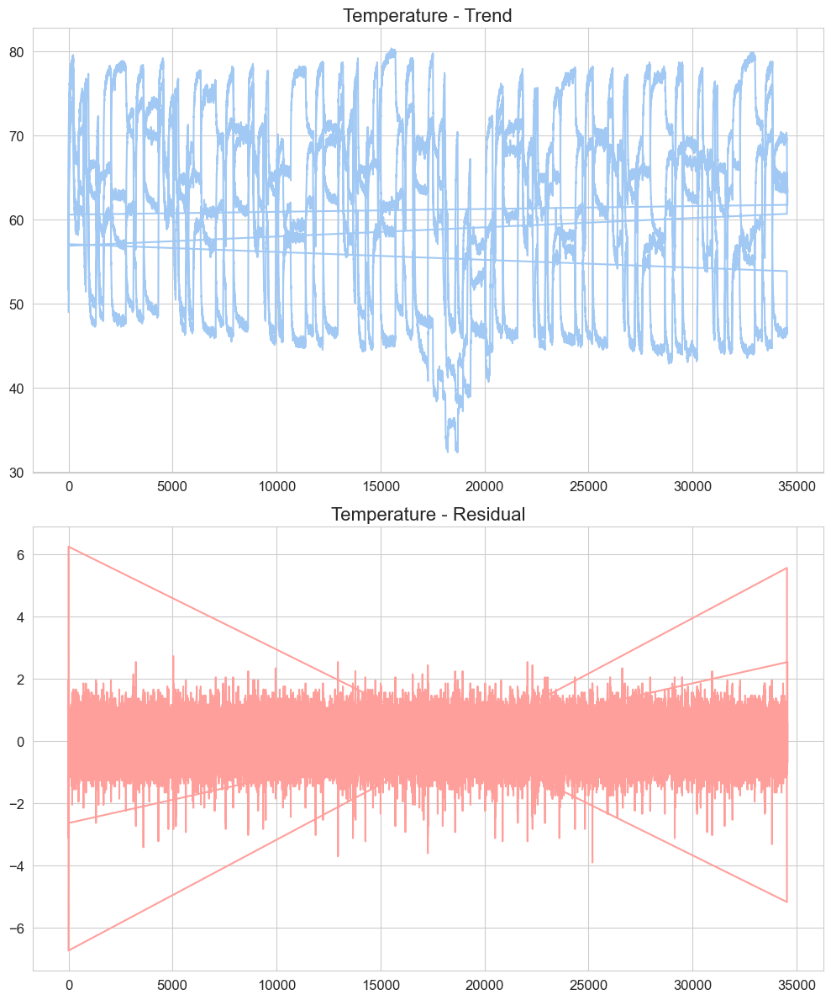

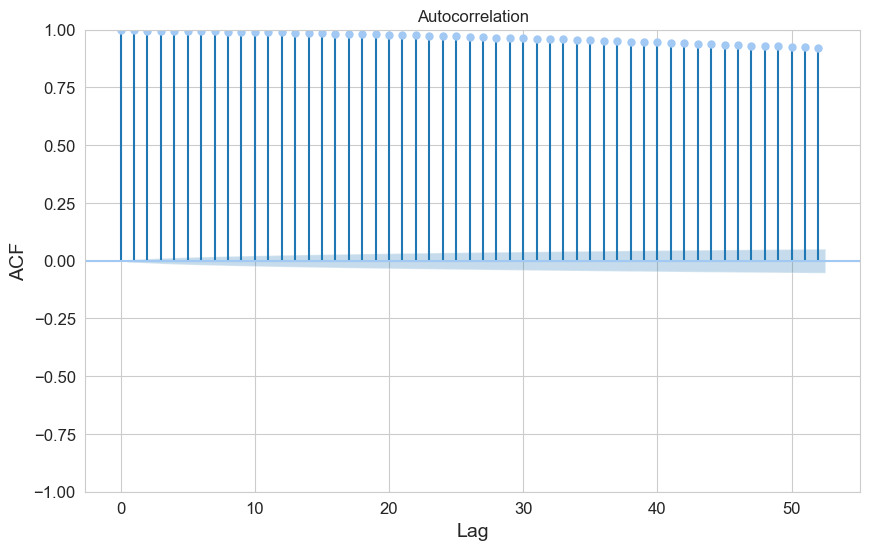

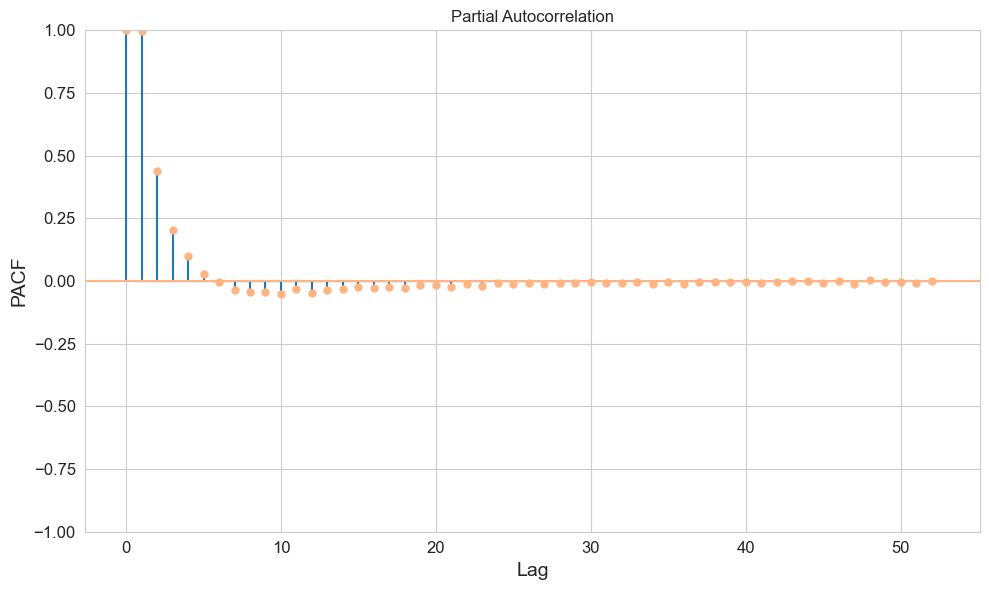

In [3]:
import re

def parse_float(value):
    try:
        if isinstance(value, str):
            match = re.search(r"[-+]?\d*\.\d+|\d+", value)
            if match:
                value = float(match.group(0))
            else:
                value = np.nan
        return float(value)
    except ValueError:
        return np.nan

root_directory = 'data'
devices = ['RPi4B8GB','RPi4B4GB','RPi4B2GB2','RPi4B2GB1']
drp_features = ['time_stamp','time','wifi_freq','link_quality_max','gpu','gpu_mem', 'net']
label = 'state'
sequence_types = ["random","pattern"] #"pattern"
# data_num = ['','_2','_3','_4']


# Define the pastel color palette


styles = ['-', ':', '--', '-.']
alfas = [0.9, 0.8, 0.7, 0.8]


for device in devices:

    print('Device:',device)

    if device == 'RPi4B2GB1':
        drp_features = drp_features + ['bit_rate']
        
    for sequence_type in sequence_types:
        print('Sequence Type:',sequence_type)
            
        df = process_files(root_directory, device, sequence_type)
        df = df.drop(columns=drp_features)
        

        # Rename columns and replace application names with more readable names
        df['state'].replace({'game': 'Gaming', 
                             'stream': 'Stream', 
                             'augmented_reality': 'AR', 
                             'mining': 'Mining', 
                             'idle': 'Idle'}, inplace=True)
        df.rename(columns={col: get_resource_name(col) for col in df.columns}, inplace=True)
        

        # feature_analysis(df,device,sequence_type)

        # target = df['state']
        # cnst_df = df[cnst_feartures]

        df = df.drop(columns=['Link Quality','Signal Level','Resource Usage State'])
        df = df.dropna()
        # df = diff_data(df, ['CPU User Time', 'CPU System Time','CPU Idle Time'])
        
        # for testing
        # df = df.head(10000)


        # Perform your analysis and plotting here
        decomposition, skewness, kurtosis, grangers_matrix, rolling_volatility, ewma_volatility = analyze_data(df,device,sequence_type)

        
        
        print("skewness:")
        print(skewness)
        print("kurtosis:")
        print(kurtosis)
        print("grangers_matrix: ")
        # Plot heatmap of grangers_matrix
        print(grangers_matrix)
        plot_heatmap(grangers_matrix, device, sequence_type, "Grangers Matrix")
        
        # Save volatility data to csv
        rolling_volatility.to_csv(os.path.join('figures','data', device, sequence_type, 'rolling_volatility.csv'))
        ewma_volatility.to_csv(os.path.join('figures','data', device, sequence_type, 'ewma_volatility.csv'))
        


        for res in df.columns:

            print('Feature:',res)

 
            print("Rolling Volatility: ")
            rolling_volatility_res = rolling_volatility[res].dropna()
            print(rolling_volatility_res.describe())

            print("EWMA Volatility: ")
            ewma_volatility_res = ewma_volatility.dropna()
            print(ewma_volatility_res.describe())

            
            
            plot_results(df, decomposition, res, device, sequence_type)